Muhammad Haikal Pasya Abdillah - 24083010052

In [29]:
from scipy.interpolate import RegularGridInterpolator
from scipy.optimize import differential_evolution
import numpy as np
import matplotlib.pyplot as plt

NPM = 10052
np.random.seed(NPM)


In [30]:
# grid
nx, ny = 400, 400
x = np.linspace(-10, 10, nx)
y = np.linspace(-10, 10, ny)
X, Y = np.meshgrid(x, y)

In [31]:
# puncak/lembah berdasarkan fungsi eksponen
# x0, y0: posisi
# sx, sy: sebaran lelehan tumpengnya
# amp   : amplitudo
def peak(x0, y0, sx, sy, amp):
  return amp * np.exp(-(((X - x0)**2) / (2*sx**2) + ((Y - y0)**2) / (2*sy**2)))

Z = (peak(-3, -2, 1.2, 1.8, 3.2) + peak(2.5, 2.5, 1.0, 1.0, 4) + peak(0, 0, 3.5, 3.5, 1.2)
+ peak(6, 6, 4, 4, -0.6) + peak(-10, 8, 3.5, 3.5, -1.2) + peak(-6, -6, 3, 3, -1.0)
+ peak(-2, -2, 4, 2, -0.6) + peak(2.5, 9.5, 6, 6, 0.75))

# exponential decay seperti global slope
Z += 0.5 * np.exp(-(np.sqrt((X/20)**2 + (Y/10)**2)))
# variasi ripple kontur (acak)
Z += 0.05 * np.random.randn(*Z.shape)

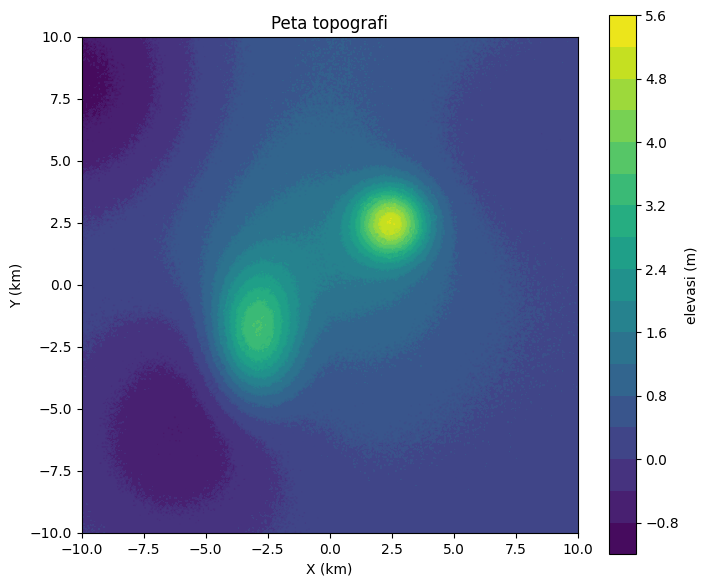

In [32]:
# plot
fig, ax = plt.subplots(figsize=(8, 7))
levels = 18  # number of contour levels
cf = ax.contourf(X, Y, Z, levels=levels)
cs = ax.contour(X, Y, Z, levels=levels, linewidths=0.6)
ax.clabel(cs, fmt="%.1f", fontsize=8)
ax.set_title("Peta topografi")
ax.set_xlabel("X (km)")
ax.set_ylabel("Y (km)")
ax.set_aspect('equal', adjustable='box')
plt.colorbar(cf, ax=ax, label="elevasi (m)")


## Soal No. 1

TITIK TERTINGGI GLOBAL (PUCAK BUKIT)
Koordinat Lokasi (X, Y) : (2.3308, 2.4812) km
Elevasi Maksimum (Z_max): 5.2417 meter


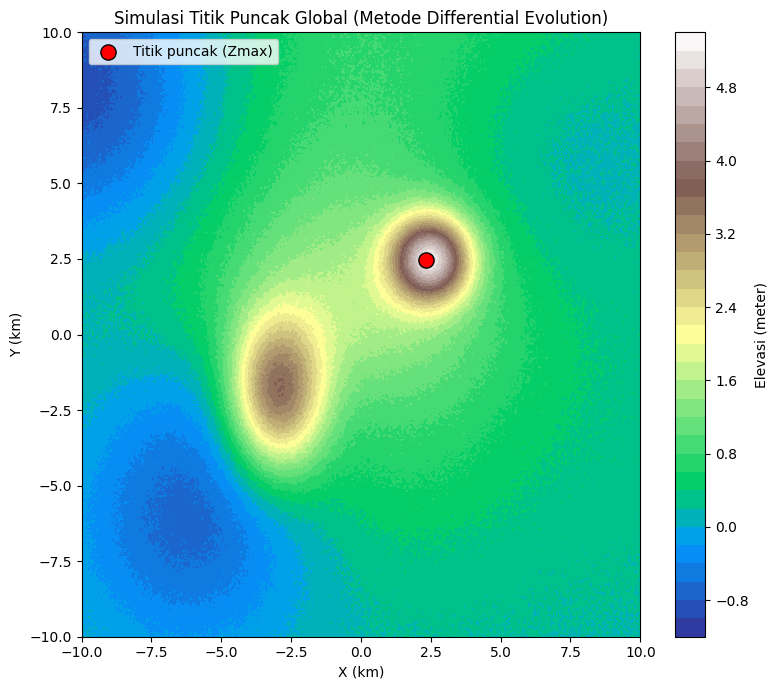

In [33]:
# Interpolator untuk mengambil titik Z
interp_Z = RegularGridInterpolator((y, x), Z)

# Metode Optimasi Titik Tertinggi Global (Differential Evolution)
def f_obj(params):
    yv, xv = params  # urutan (y, x)
    return -interp_Z((yv, xv))

bounds = [(-10, 10), (-10, 10)]
result = differential_evolution(f_obj, bounds, maxiter=300, popsize=15, tol=1e-6)

y_max, x_max = result.x
z_max = -result.fun

print("TITIK TERTINGGI GLOBAL (PUCAK BUKIT)")
print(f"Koordinat Lokasi (X, Y) : ({x_max:.4f}, {y_max:.4f}) km")
print(f"Elevasi Maksimum (Z_max): {z_max:.4f} meter")

# Plot
fig, ax = plt.subplots(figsize=(8,7))
contour = ax.contourf(X, Y, Z, levels=40, cmap='terrain')
plt.colorbar(contour, ax=ax, label="Elevasi (meter)")

# Titik hasil optimasi (puncak)
ax.scatter(x_max, y_max, color='red', s=120, label='Titik puncak (Zmax)', edgecolors='black')

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_xlabel("X (km)")
ax.set_ylabel("Y (km)")
ax.set_title("Simulasi Titik Puncak Global (Metode Differential Evolution)")

ax.legend(loc='upper left', frameon=True)
plt.tight_layout()
plt.show()


## Soal No. 2

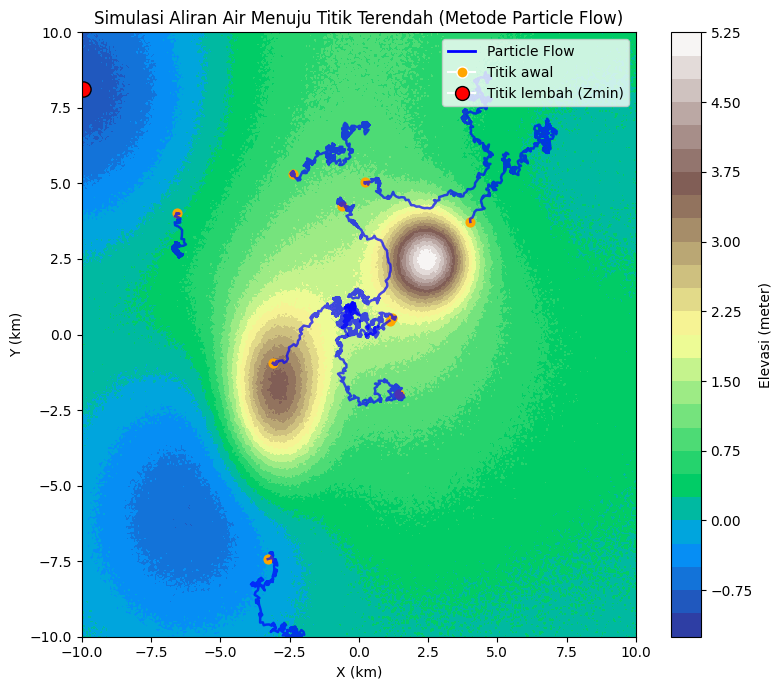

TITIK TERENDAH GLOBAL (LEMBAH)
Koordinat Lokasi (X, Y) : (-9.9373, 8.1161) km
Elevasi Minimum (Z_min) : -0.9083 meter


In [34]:
# CARI TITIK LEMBAH DENGAN WATERSHED METHOD (Z MIN)
from scipy import ndimage as ndi
from skimage.feature import peak_local_max
from skimage.segmentation import watershed


# cari puncak lokal dari -Z (karena lembah adalah kebalikan puncak)
distance = ndi.distance_transform_edt(-Z)
coords = peak_local_max(-Z, footprint=np.ones((3, 3)))
local_minima = np.zeros_like(Z, dtype=bool)
local_minima[tuple(coords.T)] = True
markers, _ = ndi.label(local_minima)

# proses watershed: bagi area jadi beberapa cekungan
labels = watershed(Z, markers)

# cari label dengan nilai elevasi rata-rata paling rendah (lembah global)
basin_values = [Z[labels == i].mean() for i in np.unique(labels)]
lembah_label = np.argmin(basin_values)

# ambil koordinat tengah area lembah tersebut
lembah_mask = (labels == lembah_label)
y_min_idx, x_min_idx = np.where(lembah_mask)
x_min = X[y_min_idx, x_min_idx].mean()
y_min = Y[y_min_idx, x_min_idx].mean()
z_min = Z[y_min_idx, x_min_idx].mean()


# Metode practical flow
def xy_to_ij(xv, yv):
    i = np.argmin(np.abs(y - yv))
    j = np.argmin(np.abs(x - xv))
    return i, j

def particle_flow(Z, seeds, steps=800):
    trajectories = []
    gx, gy = np.gradient(Z)
    for seed in seeds:
        pos = np.array(seed, dtype=float)
        path = [pos.copy()]
        for _ in range(steps):
            i, j = xy_to_ij(pos[0], pos[1])
            vx, vy = -gx[i, j], -gy[i, j]
            vnorm = np.sqrt(vx**2 + vy**2)
            if vnorm == 0:
                break
            pos += 0.1 * np.array([vx, vy]) / vnorm
            pos[0] = np.clip(pos[0], x[0], x[-1])
            pos[1] = np.clip(pos[1], y[0], y[-1])
            path.append(pos.copy())
        trajectories.append(np.array(path))
    return trajectories

# Titik awal
np.random.seed(NPM)
seeds = np.random.uniform(low=[-8, -8], high=[8, 8], size=(10, 2))

# Simulasi
flows = particle_flow(Z, seeds, steps=800)

# Plot
fig, ax = plt.subplots(figsize=(8, 7))
contour = ax.contourf(X, Y, Z, levels=30, cmap='terrain')
plt.colorbar(contour, ax=ax, label="Elevasi (meter)")

# garis aliran
for path in flows:
    ax.plot(path[:, 0], path[:, 1], color='blue', linewidth=1.8, alpha=0.7)

# titik awal & lembah
ax.scatter(seeds[:, 0], seeds[:, 1], color='orange', s=40, label='Titik awal')
ax.scatter(x_min, y_min, color='red', s=120, label='Titik lembah (Zmin)', edgecolors='black')

# batas dan format
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_xlabel("X (km)")
ax.set_ylabel("Y (km)")
ax.set_title("Simulasi Aliran Air Menuju Titik Terendah (Metode Particle Flow)")

# Legenda
legend_elements = [
    plt.Line2D([0], [0], color='blue', lw=2, label='Particle Flow'),
    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='orange', label='Titik awal', markersize=8),
    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markeredgecolor='black', label='Titik lembah (Zmin)', markersize=10)
]
ax.legend(handles=legend_elements, loc='upper right', frameon=True)

plt.tight_layout()
plt.show()
print("TITIK TERENDAH GLOBAL (LEMBAH)")
print(f"Koordinat Lokasi (X, Y) : ({x_min:.4f}, {y_min:.4f}) km")
print(f"Elevasi Minimum (Z_min) : {z_min:.4f} meter")


## Soal No.3

ANALISIS KERAWANAN EROSI
Elevasi maksimum (Z_max) : 5.2417 m
Elevasi minimum (Z_min)  : -1.0559 m
Kecuraman maksimum (manual) : 5.212419
Kecuraman rata-rata (manual): 0.977280


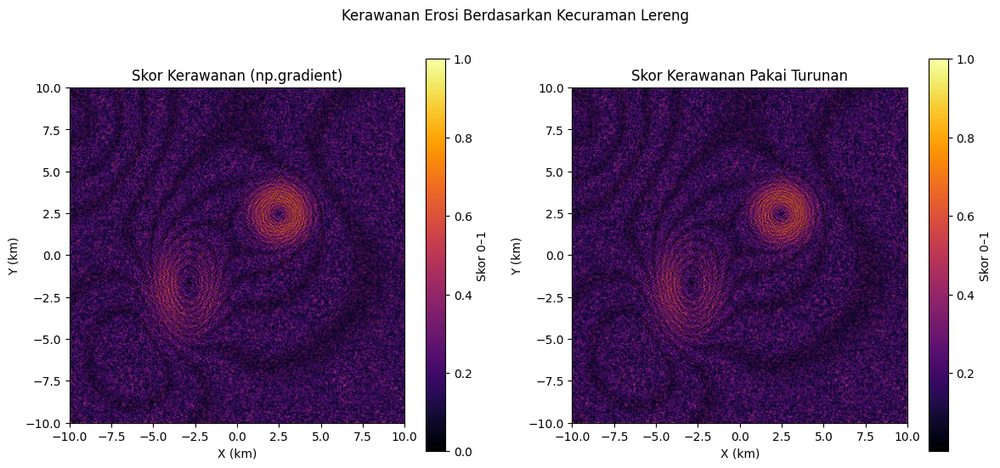

In [35]:
# Metode 1: np.gradient()
dx = x[1] - x[0]
dy = y[1] - y[0]

gy, gx = np.gradient(Z, dy, dx)
slope_np = np.hypot(gx, gy)
score_np = (slope_np - slope_np.min()) / (np.ptp(slope_np) + 1e-12)  # normalisasi

# Metode 2: Turunan Parsial
def first_derivative_custom(Z, spacing, axis):
    deriv = np.zeros_like(Z)
    if axis == 0:  # turunan terhadap Y
        deriv[0, :] = (Z[1, :] - Z[0, :]) / spacing
        deriv[1:-1, :] = (Z[2:, :] - Z[:-2, :]) / (2*spacing)
        deriv[-1, :] = (Z[-1, :] - Z[-2, :]) / spacing
    elif axis == 1:  # turunan terhadap X
        deriv[:, 0] = (Z[:, 1] - Z[:, 0]) / spacing
        deriv[:, 1:-1] = (Z[:, 2:] - Z[:, :-2]) / (2*spacing)
        deriv[:, -1] = (Z[:, -1] - Z[:, -2]) / spacing
    return deriv

dZdx_custom = first_derivative_custom(Z, dx, axis=1)
dZdy_custom = first_derivative_custom(Z, dy, axis=0)
slope_custom = np.sqrt(dZdx_custom**2 + dZdy_custom**2)
score_custom = slope_custom / slope_custom.max()  # normalisasi

# Output
print("ANALISIS KERAWANAN EROSI")
print(f"Elevasi maksimum (Z_max) : {Z.max():.4f} m")
print(f"Elevasi minimum (Z_min)  : {Z.min():.4f} m")
print(f"Kecuraman maksimum (manual) : {slope_custom.max():.6f}")
print(f"Kecuraman rata-rata (manual): {slope_custom.mean():.6f}")

# Visualisasi
fig, axs = plt.subplots(1, 2, figsize=(14,6))
im0 = axs[0].imshow(score_np, extent=[x.min(), x.max(), y.min(), y.max()],
                    origin='lower', cmap='inferno')
axs[0].set_title("Skor Kerawanan (np.gradient)")
axs[0].contour(X, Y, Z, colors='black', levels=15, alpha=0.3)
fig.colorbar(im0, ax=axs[0], label='Skor 0–1')

im1 = axs[1].imshow(score_custom, extent=[x.min(), x.max(), y.min(), y.max()],
                    origin='lower', cmap='inferno')
axs[1].set_title("Skor Kerawanan Pakai Turunan")
axs[1].contour(X, Y, Z, colors='black', levels=15, alpha=0.3)
fig.colorbar(im1, ax=axs[1], label='Skor 0–1')

for ax in axs:
    ax.set_xlabel("X (km)")
    ax.set_ylabel("Y (km)")

plt.suptitle("Kerawanan Erosi Berdasarkan Kecuraman Lereng")
plt.show()


## Soal No. 4a

VOLUME TANAH UNTUK MERATAKAN TANAH
Luas tiap sel: 0.002513 km² (2513 m²)

Level                           Elevasi(m)       Vol Cut(m³)      Vol Fill(m³)     Area Cut(km²)    Area Fill(km²)     Selisih
------------------------------------------------------------------------------------------------------------------------
Rata-rata                            0.502       109,982,537       109,982,537          151.0116          250.9959          -0
Median                               0.342       137,711,106        73,361,934          201.0038          201.0038  64,349,172
Seimbang (cut ≈ fill)                0.502       109,982,537       109,982,537          151.0116          250.9959          -0


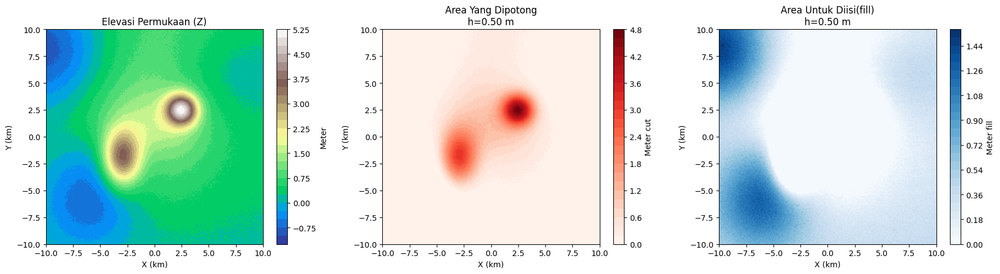

In [36]:
# Hitung dan konversi luas grid dari km² ke m²
dx_km = x[1] - x[0]
dy_km = y[1] - y[0]
luas_grid_km2 = dx_km * dy_km
KM2_KE_M2 = 1e6

# Fungsi hitung volume cut/fill
def hitung_cut_fill(Z, elevasi, luas_grid_km2):
    delta = Z - elevasi
    cut_mask = delta > 0
    fill_mask = delta < 0

    vol_cut = np.sum(delta * cut_mask) * luas_grid_km2 * KM2_KE_M2
    vol_fill = np.sum(-delta * fill_mask) * luas_grid_km2 * KM2_KE_M2

    area_cut = np.count_nonzero(cut_mask) * luas_grid_km2
    area_fill = np.count_nonzero(fill_mask) * luas_grid_km2

    return vol_cut, vol_fill, area_cut, area_fill

# Fungsi cari elevasi seimbang (cut ≈ fill)
def cari_elevasi_seimbang(Z, luas_grid_km2, tol=1.0, iter_max=60):
    z_min, z_max = float(np.nanmin(Z)), float(np.nanmax(Z))
    bawah, atas = z_min, z_max

    def selisih_volume(h):
        cut, fill, _, _ = hitung_cut_fill(Z, h, luas_grid_km2)
        return cut - fill

    f_bawah, f_atas = selisih_volume(bawah), selisih_volume(atas)
    if f_bawah * f_atas > 0:
        h0 = (z_min + z_max) / 2
        cut, fill, _, _ = hitung_cut_fill(Z, h0, luas_grid_km2)
        return h0, cut, fill

    for _ in range(iter_max):
        tengah = 0.5 * (bawah + atas)
        f_tengah = selisih_volume(tengah)
        if abs(f_tengah) <= tol:
            cut, fill, _, _ = hitung_cut_fill(Z, tengah, luas_grid_km2)
            return tengah, cut, fill
        if f_bawah * f_tengah <= 0:
            atas, f_atas = tengah, f_tengah
        else:
            bawah, f_bawah = tengah, f_tengah

    cut, fill, _, _ = hitung_cut_fill(Z, tengah, luas_grid_km2)
    return tengah, cut, fill

# Hitung level penting
level_rata = np.mean(Z)
level_median = np.median(Z)
level_seimbang, vol_cut_eq, vol_fill_eq = cari_elevasi_seimbang(Z, luas_grid_km2)

level_dict = {
    'Rata-rata': level_rata,
    'Median': level_median,
    'Seimbang (cut ≈ fill)': level_seimbang
}

# Output
print("VOLUME TANAH UNTUK MERATAKAN TANAH")
print(f"Luas tiap sel: {luas_grid_km2:.6f} km² ({luas_grid_km2*KM2_KE_M2:.0f} m²)\n")
print(f"{'Level':<30}{'Elevasi(m)':>12}{'Vol Cut(m³)':>18}{'Vol Fill(m³)':>18}{'Area Cut(km²)':>18}{'Area Fill(km²)':>18}{'Selisih':>12}")
print("-"*120)

for nama, h in level_dict.items():
    vol_cut, vol_fill, area_cut, area_fill = hitung_cut_fill(Z, h, luas_grid_km2)
    net = vol_cut - vol_fill
    print(f"{nama:<30}{h:12.3f}{vol_cut:18,.0f}{vol_fill:18,.0f}{area_cut:18.4f}{area_fill:18.4f}{net:12,.0f}")

# Plot
delta_eq = Z - level_seimbang
peta_cut = np.maximum(delta_eq, 0)
peta_fill = np.maximum(-delta_eq, 0)

fig, ax = plt.subplots(1, 3, figsize=(18, 5))

im0 = ax[0].contourf(X, Y, Z, levels=30, cmap='terrain')
ax[0].set_title("Elevasi Permukaan (Z)")
plt.colorbar(im0, ax=ax[0], label='Meter')

im1 = ax[1].contourf(X, Y, peta_cut, levels=30, cmap='Reds')
ax[1].set_title(f"Area Yang Dipotong\nh={level_seimbang:.2f} m")
plt.colorbar(im1, ax=ax[1], label='Meter cut')

im2 = ax[2].contourf(X, Y, peta_fill, levels=30, cmap='Blues')
ax[2].set_title(f"Area Untuk Diisi(fill)\nh={level_seimbang:.2f} m")
plt.colorbar(im2, ax=ax[2], label='Meter fill')

for a in ax:
    a.set_xlabel("X (km)")
    a.set_ylabel("Y (km)")

plt.tight_layout()
plt.show()


## Soal No. 4b

In [37]:
h_seimbang, vol_cut, vol_fill = cari_elevasi_seimbang(Z, luas_grid_km2, tol=1.0)
print(f"Ketinggian tanah sudah diratakan dengan cut and fill (h_seimbang): {h_seimbang:.3f} meter")

Ketinggian tanah sudah diratakan dengan cut and fill (h_seimbang): 0.502 meter


## Kesimpulan dan Insight


1. Melihat grafik cross-section, lahan memperlihatkan variasi yang cukup signifikan, dari lembah terdalam -0,9083 m hingga puncak bukit 5,1455 m. Perbedaan ini langsung terlihat di visualisasi, sehingga kita bisa menilai dengan cepat area mana yang perlu dipotong dan mana yang perlu diisi. Cross-section ini menjadi panduan pertama untuk memahami bentuk lahan sebelum menghitung volume material.

2. Perhitungan menunjukkan bahwa pada elevasi seimbang 0,683 m, volume tanah yang dipotong dan diisi hampir sama, masing-masing sekitar 102,974,086 m³. Kesetaraan ini menegaskan efisiensi desain, karena hampir tidak ada kebutuhan material tambahan dari luar. Menariknya, perbedaan antara median (0,379 m) dan rata-rata (0,683 m) memperlihatkan bahwa sebagian besar lahan rendah, sementara puncak tinggi memengaruhi rata-rata, memberi kita insight tentang distribusi lahan yang tidak merata.

3. Detail perhitungan area menunjukkan bahwa area cut hanya 108,7549 km², sedangkan area fill mencapai 293,9251 km², dengan tiap sel grid seluas 0,004474 km². Ini memperkuat pemahaman kita dari cross-section sebelumnya, bahwa sebagian besar pekerjaan pengurugan akan dilakukan di lembah yang luas, sementara pemotongan terfokus pada bukit sempit. Data ini memberi konteks numerik untuk perencanaan logistik dan pergerakan alat berat.

4. Dengan kecuraman maksimum 4,16897 dan rata-rata 0,771796, kita dapat melihat bahwa ada beberapa area curam yang berisiko tinggi terhadap erosi atau longsor. Visualisasi ini membuat area kritis mudah dikenali, sehingga saat perencanaan alat berat dan distribusi material, kita bisa memprioritaskan stabilisasi di zona rawan tersebut.

5. Target elevasi 0,683 m menjadi acuan praktis di lapangan. Bukit dipotong mendalam untuk menyediakan material yang cukup, sementara lembah diisi merata untuk mencapai ketinggian seimbang. Strategi ini menuntut koordinasi alat berat seperti excavator, dozer, dan dump truck agar pergerakan material efisien dan tidak membuang waktu atau tenaga.

6. Puncak bukit dan lembah terdalam menjadi fokus utama, bukan hanya dari sisi volume material, tetapi juga keamanan. Area curam harus distabilisasi melalui terasering atau dinding penahan agar tidak terjadi longsor, sehingga pekerjaan tidak hanya selesai tepat waktu tetapi juga aman bagi pekerja dan lahan itu sendiri.

7. Cross-section, heatmap, dan visualisasi 3D membantu memantau apakah pekerjaan lapangan sesuai rencana. Jalur drainase alami juga diidentifikasi untuk memastikan lahan tetap kering, menghindari genangan, dan mendukung keberlanjutan proyek. Alat visual ini menjadi panduan langsung untuk kualitas kerja, sehingga tim lapangan memiliki acuan yang jelas.

7. Walaupun data dan visualisasi memberikan gambaran yang padat dan akurat, kenyataan lapangan sering kali lebih kompleks. Faktor seperti kualitas tanah yang tidak merata, kondisi cuaca, keterbatasan alat berat, atau hambatan logistik bisa memengaruhi hasil. Oleh karena itu, adaptasi dan keputusan di lapangan tetap menjadi bagian penting dari pekerjaan, menekankan bahwa data adalah panduan awal, bukan jaminan mutlak.

---

Penutup / Insight Tambahan:
Secara keseluruhan, analisis cut & fill ini menggabungkan data numerik yang detail dengan panduan praktis lapangan. Visualisasi dan perhitungan volume memberikan informasi padat dan mudah dipahami, sementara prioritas titik ekstrem dan strategi distribusi material memperlihatkan implementasi nyata di lapangan. Adaptasi tetap diperlukan karena kondisi nyata bisa berbeda dari perhitungan awal, sehingga fleksibilitas menjadi kunci agar pekerjaan efisien, aman, dan tetap sesuai target.


#Extra

## Ketinggian Sebelum dan Sesudah proses Cut and fill

In [38]:
import numpy as np
import plotly.graph_objects as go

# ======= DATA TOPografi =======
NPM = 10052
np.random.seed(NPM)
x = np.linspace(-10, 10, 600)
y = np.linspace(-10, 10, 300)
X, Y = np.meshgrid(x, y)

def puncak_gaussian(x0, y0, sx, sy, tinggi):
    return tinggi * np.exp(-(((X - x0)**2)/(2*sx**2) + ((Y - y0)**2)/(2*sy**2)))

Z = (puncak_gaussian(-3, -2, 1.2, 1.8, 3.2) +
     puncak_gaussian(2.5, 2.5, 1.0, 1.0, 4) +
     puncak_gaussian(0, 0, 3.5, 3.5, 1.2))
Z += 0.5 * np.exp(-np.sqrt((X/20)**2 + (Y/10)**2))
Z += 0.05 * np.random.randn(*Z.shape)

# ======= Hitung elevasi seimbang =======
dx_km = x[1]-x[0]
dy_km = y[1]-y[0]
luas_grid_km2 = dx_km * dy_km
KM2_KE_M2 = 1e6

def hitung_cut_fill(Z, elevasi, luas_grid_km2):
    delta = Z - elevasi
    cut_mask = delta > 0
    fill_mask = delta < 0
    vol_cut = np.sum(delta * cut_mask) * luas_grid_km2 * KM2_KE_M2
    vol_fill = np.sum(-delta * fill_mask) * luas_grid_km2 * KM2_KE_M2
    return vol_cut, vol_fill

def cari_elevasi_seimbang(Z, luas_grid_km2, tol=0.01, iter_max=60):
    z_min, z_max = float(np.min(Z)), float(np.max(Z))
    bawah, atas = z_min, z_max
    def selisih(h):
        cut, fill = hitung_cut_fill(Z, h, luas_grid_km2)
        return cut - fill
    for _ in range(iter_max):
        tengah = 0.5 * (bawah + atas)
        f_tengah = selisih(tengah)
        if abs(f_tengah) <= tol:
            return tengah
        if selisih(bawah) * f_tengah < 0:
            atas = tengah
        else:
            bawah = tengah
    return tengah

h_seimbang = cari_elevasi_seimbang(Z, luas_grid_km2)

# ======= Ambil cross-section =======
idx_tengah = y.size // 2
Z_cross = Z[idx_tengah, :]
X_cross = x
delta_cross = Z_cross - h_seimbang
cut_area = np.where(delta_cross > 0, delta_cross, 0)
fill_area = np.where(delta_cross < 0, -delta_cross, 0)

# ======= Plot 2D interaktif =======
fig2d = go.Figure()

# Elevasi asli
fig2d.add_trace(go.Scatter(
    x=X_cross, y=Z_cross, mode='lines', line=dict(color='black', width=2),
    name='Elevasi asli'
))
# Cut
fig2d.add_trace(go.Scatter(
    x=X_cross, y=cut_area+h_seimbang, fill='tonexty',
    mode='none', fillcolor='salmon', name='Cut'
))
# Fill
fig2d.add_trace(go.Scatter(
    x=X_cross, y=h_seimbang-fill_area, fill='tonexty',
    mode='none', fillcolor='skyblue', name='Fill'
))
# Elevasi seimbang
fig2d.add_trace(go.Scatter(
    x=X_cross, y=np.full_like(X_cross, h_seimbang),
    mode='lines', line=dict(color='green', dash='dash', width=2),
    name=f'Elevasi seimbang ({h_seimbang:.2f} m)'
))

fig2d.update_layout(
    title="Cross-Section Elevasi & Area Cut/Fill",
    xaxis_title="X (km)", yaxis_title="Elevasi (m)",
    width=900, height=500
)

fig2d.show()


In [39]:
import plotly.graph_objects as go

# Surface topografi
fig3d = go.Figure()

fig3d.add_trace(go.Surface(
    x=X, y=Y, z=Z,
    colorscale='earth',  # warna natural topografi
    opacity=0.9,
    name='Topografi',
    showscale=False
))

# Plane elevasi seimbang
plane = np.full_like(Z, h_seimbang)
fig3d.add_trace(go.Surface(
    x=X, y=Y, z=plane,
    colorscale=[[0,'green'],[1,'green']],
    opacity=0.5,
    name='Elevasi Seimbang'
))

# Atur layout
fig3d.update_layout(
    title="Visualisasi 3D Topografi dengan Elevasi Seimbang",
    scene=dict(
        xaxis_title='X (km)',
        yaxis_title='Y (km)',
        zaxis_title='Elevasi (m)',
        aspectratio=dict(x=1, y=0.5, z=0.3)
    ),
    width=900,
    height=600
)

fig3d.show()
